<h1 align='center'>Коллективный проект команды №4-1-1</h1>
<h2 align='center'>Основные положения</h2>

BMI - Индекс массы тела
- 16 и менее - выраженный дефицит массы тела. 
- 16…18,5 - недостаточная (дефицит) масса тела. 
- 18,5…25 - нормальная масса тела. 
- 25…30 - избыточная масса тела (предожирение). 
- 30…35 - ожирение 1 степени. 
- 35…40 - ожирение 2 степени. 
- 40 и более - ожирение 3 степени.
<h2 align='center'>Анализ данных</h2>


**График №1**. Круговая диаграмма.

Эта диаграмма демонстрирует распределение некоторых заболеваний по возрастным категориям. Я разделил людей на возрастные категории: молодые (до 18), зрелый (до 34), средний (до 69), пожилой (до 74) и старческий (до 150).

На диаграмме представлены круговые графики для каждой возрастной категории, где показатели здоровья и трех болезней (диабет, гипертония и заболевания сердца) различаются в зависимости от возраста:
- Молодой: Здесь практически нет разделения секторов, что указывает на высокую долю здоровых людей в этой возрастной категории.
- Зрелый: Еще раз виден большой сектор здоровых, но уже начинают появляться и болезни, причем доля гипертонии и диабета немного больше, чем заболеваний сердца.
- Средний: Значительное увеличение секторов диабета (10.8%), гипертонии (9.1%) и заболеваний сердца (3.8%), говорящее о снижении доли здоровых (75.9%).
- Пожилой: Здоровых остается менее половины (46.7%). Секторы диабета (21.4%) и гипертонии (17.7%) увеличиваются, в то время как доля заболеваний сердца (12.2%) также растет.
- Старческий: Дальнейшее снижение доли здоровых до 45.4%. Диабет (19.7%) и гипертония (19.2%) имеют почти одинаковую долю, а заболевания сердца составляют (15.8%).
В целом, диаграмма показывает ожидаемую тенденцию: с возрастом увеличивается вероятность возникновения указанных заболеваний, и уменьшается доля здоровых.


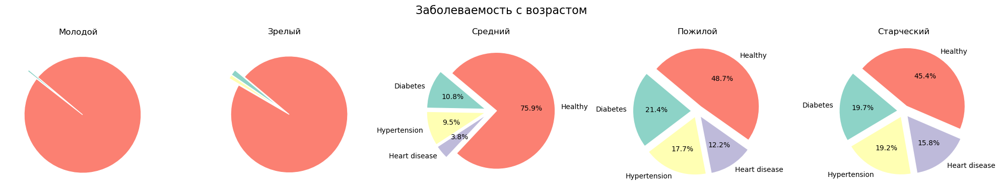

In [1]:
import pandas as pd
import matplotlib.pyplot as plt

df = pd.read_csv('diabetes_prediction_dataset.csv')

# Преобразование столбца age в нужный тип данных
df['age'] = pd.to_numeric(df['age'], errors='coerce')

# Разделение на возрастные группы
bins = [0, 18, 34, 69, 74, 150]
labels = ['Молодой', 'Зрелый', 'Средний', 'Пожилой', 'Старческий']
df['age_group'] = pd.cut(df['age'], bins=bins, labels=labels, right=False)

# Создание круговых диаграмм
fig, axes = plt.subplots(1, 5, figsize=(20, 4))

# Значения для параметра explode
explode = (0.1, 0.1, 0.1, 0.1)

# Цвета для категорий из Set3
colors = plt.cm.Set3.colors

for i, group in enumerate(labels):
    subset = df[df['age_group'] == group]
    data = [
        subset['diabetes'].sum(),
        subset['hypertension'].sum(),
        subset['heart_disease'].sum(),
        len(subset) - subset['diabetes'].sum() - subset['hypertension'].sum() - subset['heart_disease'].sum()
    ]
    labels = [''] * 4  # пустые строки
    autopct = ''

    if i >= 2:  # задаем подписи и проценты только для трех последних диаграмм
        labels = ['Diabetes', 'Hypertension', 'Heart disease', 'Healthy']
        autopct = '%1.1f%%'

    axes[i].pie(data, labels=labels, autopct=autopct, startangle=140, wedgeprops={'edgecolor': 'white'}, explode=explode, colors=colors)
    axes[i].set_title(f'{group}')

plt.suptitle('Заболеваемость с возрастом', fontsize=16)
plt.tight_layout()
plt.show()

**График №2**. Круговая диаграмма.

На представленных диаграммах показано состояние здоровья мужчин и женщин. Круговые диаграммы разделены на четыре категории для каждого пола: здоровые и больные:  диабетом, гипертонией и сердечными заболеваниями.

Можно сделать вывод, что среди женщин доля здоровых выше, чем среди мужчин. Также у женщин ниже проценты людей страдающих диабетом, гипертонией и сердечными заболеваниями, по сравнению с мужчинами. Заметно, что сердечные заболевания у женщин встречаются значительно реже (2.7% против 5.7% у мужчин). 

Факт, что у мужчин общее число заболеваний может быть выше, чем у женщин, может быть обусловлен различными факторами, включая биологические, поведенческие и социальные.

1. Посмотрим на генетический фактор, а именно на правило, что у мужчин более высокий базовый уровень тестостерона, который может влиять на риск развития некоторых видов рака и сердечно-сосудистых заболеваний)

2. Поведенческий: мужчины имеют тенденцию к более рискованному поведению, включая курение, употребление алкоголя и наркотиков, агрессивное вождение и нежелание искать медицинскую помощь.

3. Социально-поведенческий: Женщины чаще посещают врача для регулярных проверок, что может приводить к более раннему обнаружению и лечению заболеваний. Социальные ожидания также могут побуждать мужчин игнорировать симптомы, откладывая посещение врача до тех пор, пока проблемы со здоровьем не станут серьезными.

4. Профессиональные и экологические риски: Мужчины чаще работают на опасных производствах или занимаются тяжёлым физическим трудом, что увеличивает риск профессионального заболевания или травм.

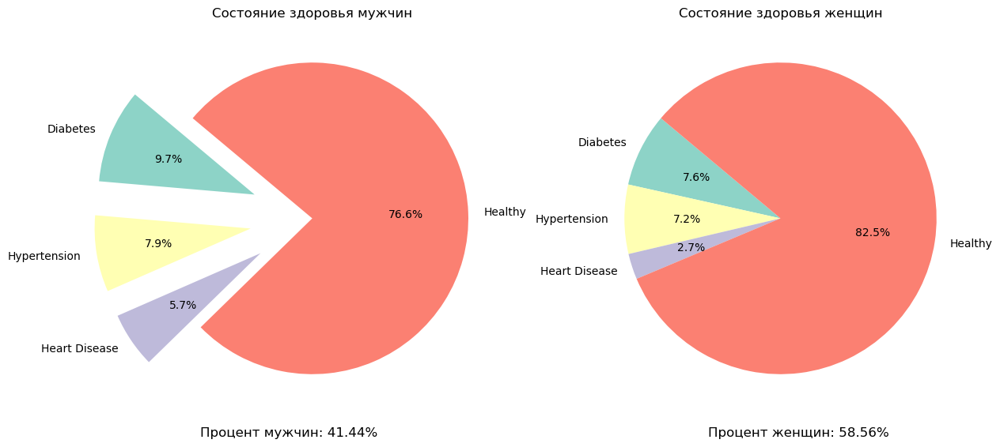

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
# Загрузка данных
df = pd.read_csv('diabetes_prediction_dataset.csv')

# Создание поднаборов данных для мужчин и женщин
male_subset = df[df['gender'] == 'Male']
female_subset = df[df['gender'] == 'Female']

# Создание круговых диаграмм для мужчин
fig, axes = plt.subplots(1, 2, figsize=(14, 7))

# Мужчины
male_labels = ['Diabetes', 'Hypertension', 'Heart Disease', 'Healthy']
male_data = [
    male_subset['diabetes'].sum(),
    male_subset['hypertension'].sum(),
    male_subset['heart_disease'].sum(),
    len(male_subset) - male_subset['diabetes'].sum() - male_subset['hypertension'].sum() - male_subset['heart_disease'].sum()
]
colors = plt.cm.Set3.colors
explode = (0.4, 0.4, 0.4, 0)  # добавляем отступ к первому сектору
axes[0].pie(male_data, labels=male_labels, autopct='%1.1f%%', startangle=140, colors=colors, explode=explode)

axes[0].set_title('Состояние здоровья мужчин')

# Женщины
female_labels = ['Diabetes', 'Hypertension', 'Heart Disease', 'Healthy']
female_data = [
    female_subset['diabetes'].sum(),
    female_subset['hypertension'].sum(),
    female_subset['heart_disease'].sum(),
    len(female_subset) - female_subset['diabetes'].sum() - female_subset['hypertension'].sum() - female_subset['heart_disease'].sum()
]
axes[1].pie(female_data, labels=female_labels, autopct='%1.1f%%', startangle=140, colors=colors)
axes[1].set_title('Состояние здоровья женщин')
percent_male = len(male_subset) / (len(male_subset) + len(female_subset)) * 100
percent_female = len(female_subset) / (len(male_subset) + len(female_subset)) * 100

# Добавление текст с процентом мужчин и женщин
fig.text(0.28, 0.1, 'Процент мужчин: %.2f%%' % percent_male, ha='center', fontsize=12)
fig.text(0.74, 0.1, 'Процент женщин: %.2f%%' % percent_female, ha='center', fontsize=12)
plt.show()

**График №3**. Диаграмма рассеивания 2D.

Анализ графика рассеивания зависимости возраста от индекса массы тела (ИМТ) с учетом пересечения этой информации с наличием диабета.

Анализ возрастной зависимости:Наблюдается значительное увеличение красных точек - больных диабетом после 40 лет, это говорить о том, что возраст является фактором риска для развития диабета, что соответствует общепринятому понятию (с возрастом риск диабета повышается).

Анализ зависимости от ИМТ: Есть и порог по ИМТ на графике. ИМТ считается одним из показателей здоровья, причем значения 25-29.9 указывают на избыточный вес, а 30 и выше классифицируется как ожирение. Тренд такой, что при возрасте 40 и выше и значении ИМТ выше 25 вероятность возникновения диабета гораздо выше обычного веса, так как красные точки скорее расположены в зоне повышенного ИМТ. Естественно, что есть и исключения.

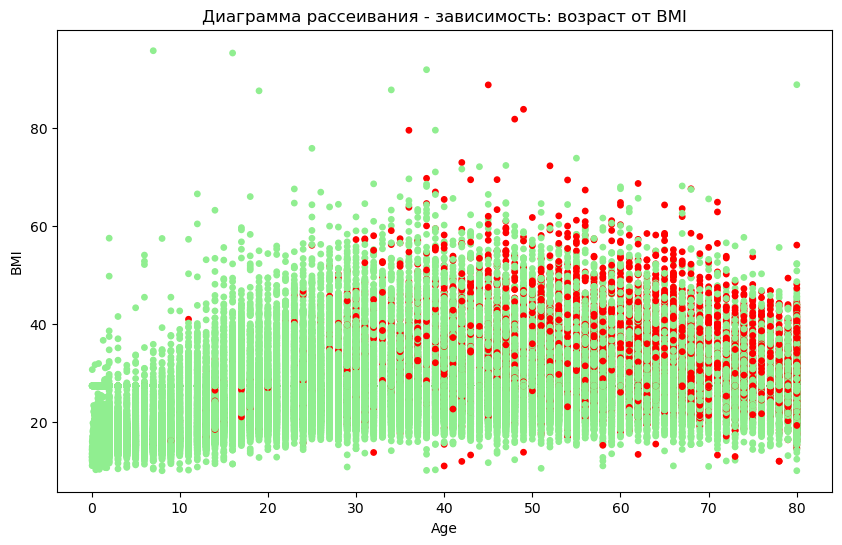

In [3]:
import pandas as pd
import matplotlib.pyplot as plt

data = pd.read_csv('diabetes_prediction_dataset.csv')

plt.figure(figsize=(10, 6))
plt.scatter(data['age'], data['bmi'], c=data['diabetes'].map({0: 'lightgreen', 1: 'Red'}), s=15)

plt.xlabel('Age')
plt.ylabel('BMI')
plt.title('Диаграмма рассеивания - зависимость: возраст от BMI')

plt.show()

**График №4**. Диаграмма рассеивания 3D.

По сути тоже самое, что и 2D —— совмещение двух 2D диаграмм рассеивания.

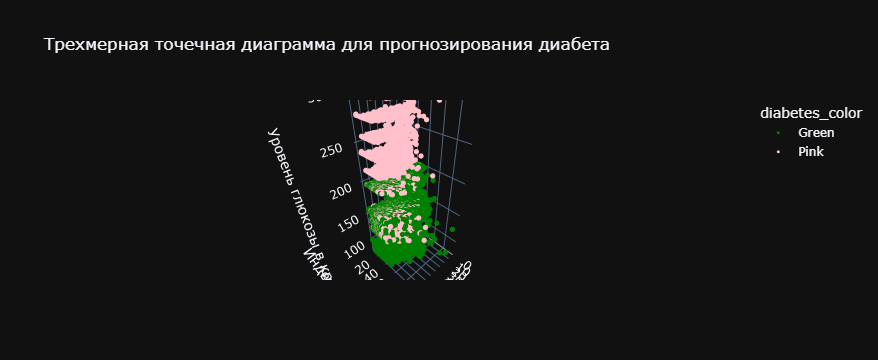

In [4]:
import pandas as pd
import plotly.express as px

# Загрузка данных
df = pd.read_csv('diabetes_prediction_dataset.csv')

# Выбор переменных для визуализации
# В данном примере мы выбрали возраст, ИМТ и уровень глюкозы в крови
x, y, z = 'age', 'bmi', 'blood_glucose_level'

# Перекодирование столбца diabetes для визуализации: 0 для здоровых, 1 для больных диабетом
df["diabetes_color"] = df["diabetes"].apply(lambda x: 'Pink' if x == 1 else 'Green')

# Построение трехмерной диаграммы рассеивания
fig = px.scatter_3d(df, x=x, y=y, z=z, color='diabetes_color', color_discrete_map={'Pink': 'pink', 'Green': 'green'},
                    title="Трехмерная точечная диаграмма для прогнозирования диабета", template="plotly_dark")

# Установка размера маркеров
fig.update_traces(marker=dict(size=3))
fig.update_layout(scene=dict(
                    xaxis_title='Возраст',
                    yaxis_title='Индекс массы тела',
                    zaxis_title='Уровень глюкозы в крови'
                ))

fig.show()

**График №5**. Тепловая карта

Эта тепловая карта представляет собой визуализацию коэффициентов корреляции между различными медицинскими параметрами и заболеваниями. Сначала обратим внимание на корреляцию заболеваний и параметров. 

Артериальная гипертензия (гипертония) умеренно коррелирует с возрастом. Ну и на самом деле, с ней сталкиваются 30-45 процентов взрослых, то есть вероятность гипертонии с возрастом увеличивается. Заболевания сердца примерно также коррелируют с возрастом.

Уровень глюкозы в крови и средний уровень глюкозы за длительный срок имеют наибольшую корреляцию с диабетом, что ожидаемо, так как они являются показателем сахарного диабета.

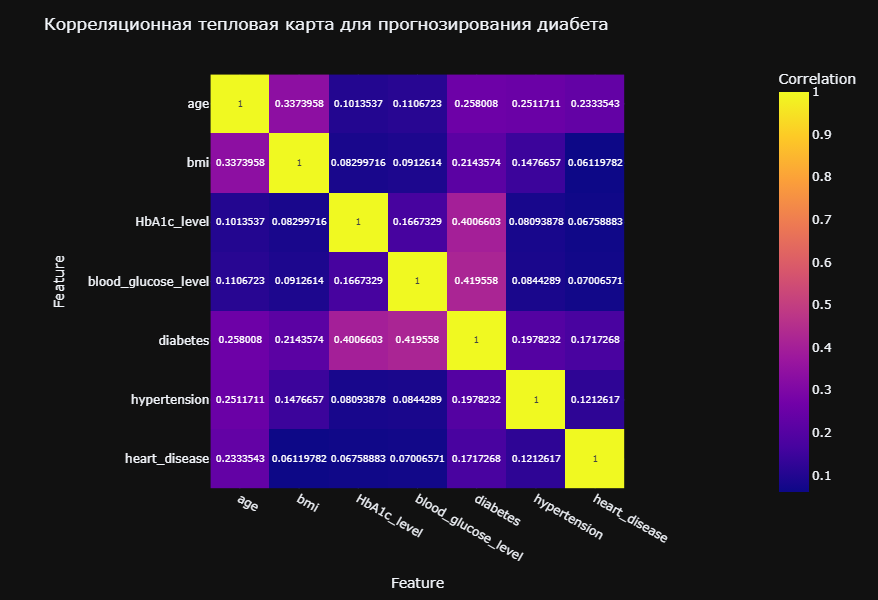

In [11]:
import pandas as pd
import plotly.express as px

# Загрузка данных
df = pd.read_csv('diabetes_prediction_dataset.csv')

# Выберем количественные переменные
numeric_columns = ['age', 'bmi', 'HbA1c_level', 'blood_glucose_level', 'diabetes']

binary_columns = ['hypertension', 'heart_disease']
selected_columns = numeric_columns + binary_columns

# Очистим данные от возможных пропущенных значений
df_selected = df[selected_columns].dropna()

# Вычислим корреляционную матрицу
corr_matrix = df_selected.corr(method='pearson')

# Построим тепловую карту
fig = px.imshow(corr_matrix,
                text_auto=True, # Автоматически добавит значения на тепловую карту
                labels=dict(x="Feature", y="Feature", color="Correlation"),
                x=corr_matrix.columns,
                y=corr_matrix.columns,
                template="plotly_dark")

# Назначим заголовок графика
fig.update_layout(title='Корреляционная тепловая карта для прогнозирования диабета', width=900, height=600)

fig.show()

**График №6**. Мозаичная диаграмма.

Следует начать с того, что вся диаграмма разделена на две группы - мужчины и женщины. Далее идет распределение по возрасту. И в каждой ячейке возраста есть деление на имеющих диабет и не имеющих. Размер ячейки соответствует количеству людей в этой группе, подгруппе.

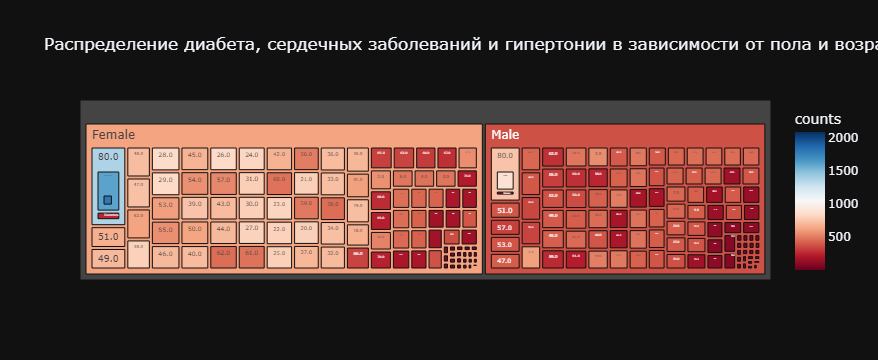

In [6]:
import pandas as pd
import plotly.express as px

# Загрузка данных из CSV
df = pd.read_csv('diabetes_prediction_dataset.csv')

# Заменяем 0 и 1 на более понятные обозначения
df['diabetes'] = df['diabetes'].map({0: 'No Diabetes', 1: 'Diabetes'})
df['heart_disease'] = df['heart_disease'].map({0: 'No Heart Disease', 1: 'Heart Disease'})
df['hypertension'] = df['hypertension'].map({0: 'No Hypertension', 1: 'Hypertension'})

# Агрегация всех данных для визуализации
grouped_data = df.groupby(['gender', 'age', 'diabetes', 'heart_disease', 'hypertension']).size().reset_index(name='counts')

# Создание мозаичной диаграммы с дополнительными условиями
fig = px.treemap(grouped_data, path=['gender', 'age', 'diabetes', 'heart_disease', 'hypertension'], values='counts',
                 color='counts',
                 color_continuous_scale='RdBu',
                 title='Распределение диабета, сердечных заболеваний и гипертонии в зависимости от пола и возраста',
                 template="plotly_dark")

# Показываем фигуру
fig.show()

**График №7**. Мозаичная улучшенная диаграмма.

Тоже самое, что и шестая, только добавлены все болезни, которые есть в таблице. Соответственно из-за этого сама диаграмма выходит  более содержательной. Можно посмотреть на количество количество больных в определенной группе.

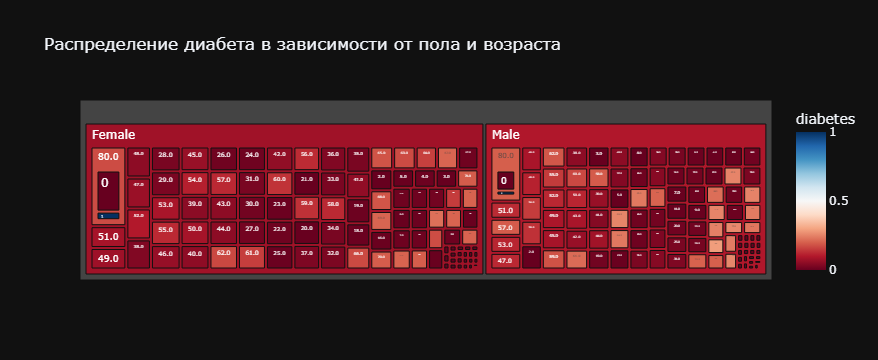

In [7]:
import pandas as pd
import plotly.express as px

# Загрузка данных из CSV
df = pd.read_csv('diabetes_prediction_dataset.csv')

# Данные для визуализации
grouped_data = df.groupby(['gender', 'age', 'diabetes']).size().reset_index(name='counts')

# Создание мозаичной диаграммы
fig = px.treemap(grouped_data, path=['gender', 'age', 'diabetes'], values='counts',
                 color='diabetes',
                 color_continuous_scale='RdBu',
                 title='Распределение диабета в зависимости от пола и возраста',
                 template="plotly_dark")
fig.show()

**График №8**. Диаграмма размаха.

Эта диаграмма размаха или иначе ящик с усами представляет распределение индекса массы тела (BMI) у различных групп людей в зависимости от их истории курения. По горизонтальной оси представлены группы курильщиков: "never" (никогда не курили), "current" (курят в настоящее время), "former" (бывшие курильщики) и "not current" (в настоящее время не курят). По вертикальной оси отложен индекс массы тела (BMI).

Во всех группах наблюдается разброс значений BMI, что указывает на то, что в каждой категории есть люди с различным уровнем BMI. Присутствие выбросов (точек вне усов) в каждой группе свидетельствует о том, что есть люди со значительно отличающимся весом.

Анализирую и меняя параметры диаграммы, мы заметили, что данные словно нормализованы для нейросети. Потому что медианное значение, например, в этом варианте практически одинаковое и если отличается, то на десятые доли. Нормализация данных – это важный этап предобработки данных в машинном обучении и анализе данных, который позволяет привести все данные к единой шкале без искажения различий в диапазонах значений.

В целом, диаграмма предоставляет информацию о том, как курение может быть связано с BMI.

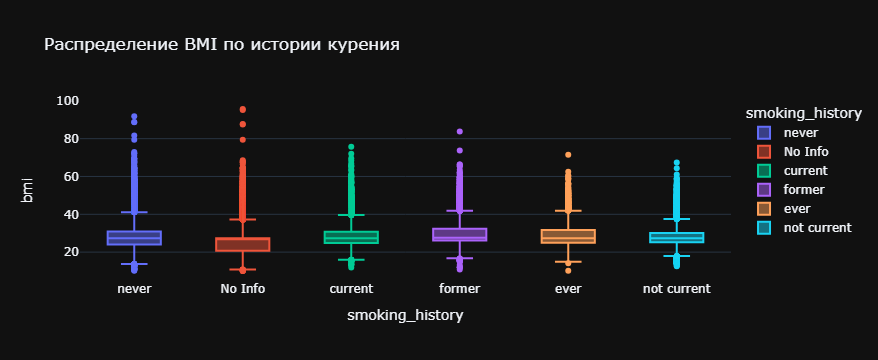

In [12]:
import pandas as pd
import plotly.express as px
df = pd.read_csv('diabetes_prediction_dataset.csv')
fig = px.box(df,
             x='smoking_history',
             y='bmi',
             color='smoking_history',
             title='Распределение BMI по истории курения',
             template="plotly_dark")
fig.show()

**График №9**. График параллельных координат.

График параллельных координат, который является инструментом визуализации для анализа многомерных данных. Каждая вертикальная линия на графике представляет одну переменную, а соединительные линии между вертикальными линиями представляют отдельные записи в наборе данных.

График включает в себя несколько переменных, таких как гипертония (Hypertension), сердечные заболевания (Heart Disease), уровень глюкозы , индекс массы тела (BMI), возраст (Age) и другие.

Красные линии показывают записи для людей, больных диабетом, а зеленые — для здоровых. Это позволяет зрительно оценить, как различные переменные коррелируют с наличием диабета у исследуемых людей.

Анализируя график, можно искать закономерности или выбросы в данных. Например, можно заметить:
- Какие переменные имеют большее или меньшее различие между группами больных и здоровых (например, если красные линии выглядят очень различимо от зеленых на определенной оси, это может указывать на сильную корреляцию этой переменной с заболеванием).

Однако из-за большого количества данных может возникнуть "шум", когда множество линий наложены друг на друга, что затрудняет некоторые аспекты анализа. Использование интерактивных элементов для упрощения визуального обзора могут улучшить читаемость графика. Что как раз доступно на этом графике.


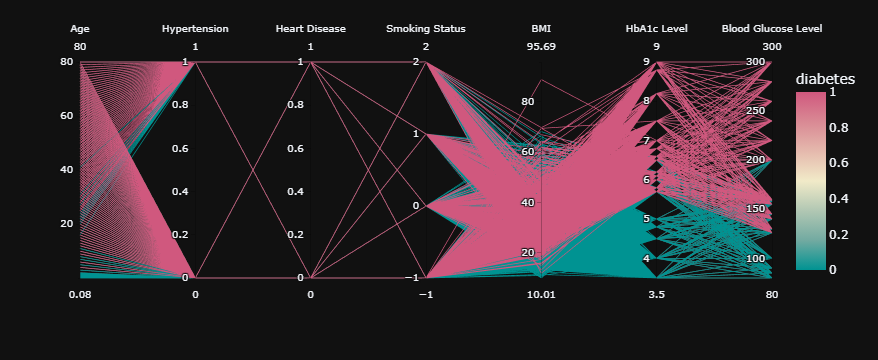

In [13]:
import pandas as pd
import plotly.express as px

df = pd.read_csv('diabetes_prediction_dataset.csv')

# smoking_history в числа
def convert_smoking(smoking):
    if smoking == 'current':
        return 2
    elif smoking == 'former' or smoking == 'not current' or smoking == 'ever':
        return 1
    elif smoking == 'never':
        return -1
    elif smoking == 'no info':
        return 0
    else:
        return None

# Применение функции выше к smoking_history и создание нового столбца
df['smoking_status'] = df['smoking_history'].apply(convert_smoking)

# Построение Parallel Coordinates Plot
fig = px.parallel_coordinates(df,
                              color="diabetes",
                              dimensions=['gender', 'age', 'hypertension', 'heart_disease',
                                          'smoking_status', 'bmi', 'HbA1c_level', 'blood_glucose_level'],
                              labels={'smoking_status': 'Smoking Status', 'gender': 'Gender', 'age': 'Age',
                                      'hypertension': 'Hypertension', 'heart_disease': 'Heart Disease',
                                      'bmi': 'BMI', 'HbA1c_level': 'HbA1c Level', 'blood_glucose_level': 'Blood Glucose Level'},
                              color_continuous_scale=px.colors.diverging.Tealrose,
                              color_continuous_midpoint=0.5,
                              template="plotly_dark")
fig.show()